In [2]:
import scanpy as sc
import numpy as np
import pandas as pd
import anndata as ann
import seaborn as sns
import matplotlib.pyplot as plt
from matplotlib import colors
from matplotlib import rcParams
import os
#import custom_functions as cf

Add date.

In [3]:
from datetime import date

In [4]:
today = date.today().strftime("%y%m%d")

Add my color scheme.

In [5]:
colors2 = plt.cm.RdYlBu_r(np.linspace(0, 1, 128))
colors3 = plt.cm.Greys_r(0.7)
colorsComb = np.vstack([colors3, colors2])
mymap = colors.LinearSegmentedColormap.from_list('my_colormap', colorsComb)

Set parameters for plots in scanpy

In [6]:
sc.settings.set_figure_params(dpi=80)

sc.set_figure_params(scanpy=True, dpi=80, dpi_save=250,
                     frameon=True, vector_friendly=True,
                     color_map='YlGnBu', format='pdf', transparent=False,
                     ipython_format='png2x')

# Introduction

In this notebook, we create visualisations of the ageing liver datasets of the mouse.

# Load data

Set paths to the project.

In [7]:
project_dir = '/lustre/groups/ml01/workspace/maren.buettner/Martinez_Liver_HPC/'

In [8]:
data_dir = project_dir + 'data/'

In [9]:
sc.settings.figdir = './../figures/'

Read anndata objects.

In [10]:
adata_wt_young = sc.read(data_dir + 'snRNAseq_mouse_hepatocytes_young_cells_filtered_TPM_jul21_annotated.h5ad')
adata_wt_old = sc.read(data_dir + 'snRNAseq_mouse_hepatocytes_old_cells_filtered_TPM_jul21_annotated.h5ad')

In [11]:
adata_young_HNF4 = sc.read(data_dir + 'snRNAseq_mouse_hepatocytes_young_HNF4-KO_filtered_TPM_jul21_annotated.h5ad')
adata_old_HNF4 = sc.read(data_dir + 'snRNAseq_mouse_hepatocytes_old_HNF4-KO_filtered_TPM_jul21_annotated.h5ad')
adata_young_CTCF = sc.read(data_dir + 'snRNAseq_mouse_hepatocytes_young_CTCF-KO_filtered_TPM_jul21_annotated.h5ad')
adata_old_CTCF = sc.read(data_dir + 'snRNAseq_mouse_hepatocytes_old_CTCF-KO_filtered_TPM_jul21_annotated.h5ad' )
adata_young_CEBPA = sc.read(data_dir + 'snRNAseq_mouse_hepatocytes_young_CEBPA-KO_filtered_TPM_jul21_annotated.h5ad')
adata_old_CEBPA = sc.read(data_dir + 'snRNAseq_mouse_hepatocytes_old_CEBPA-KO_filtered_TPM_jul21_annotated.h5ad')

We merge `adata_young` and `adata_old` in order to use the separately created cell type annotation.

In [12]:
adata_all = ann.concat([adata_wt_young, adata_wt_old, 
                        adata_young_HNF4, adata_old_HNF4,
                        adata_young_CTCF, adata_old_CTCF,
                        adata_young_CEBPA, adata_old_CEBPA,
                       ], index_unique=None)

In [13]:
adata_all.uns = adata_wt_young.uns
adata_all.varm = adata_wt_young.varm
adata_all.var['gene_name'] = adata_wt_young.var['gene_name']

Add covariate combining age and ploidy.

In [14]:
age_ploidy = [adata_all.obs['age_grouped'][idx] + ' ' + adata_all.obs['ploidy'][idx] for idx in range(adata_all.n_obs)]

In [15]:
adata_all.obs['age_ploidy'] = pd.Categorical(age_ploidy, categories=['young 2n', 'young 4n', 'old 2n', 'old 4n'])

Add strain information to the age and ploidy covariate.

In [16]:
strain_age_ploidy = [adata_all.obs['strain'][idx] + ' ' + 
                     adata_all.obs['age_grouped'][idx] + ' ' + 
                     adata_all.obs['ploidy'][idx] for idx in range(adata_all.n_obs)]

In [17]:
adata_all.obs['strain_age_ploidy'] = pd.Categorical(strain_age_ploidy, 
                                categories=['C57Bl6/J young 2n', 'C57Bl6/J young 4n', 
                                            'C57Bl6/J old 2n', 'C57Bl6/J old 4n',
                                            'HNF4 KO young 2n', 'HNF4 KO young 4n', 
                                            'HNF4 KO old 2n', 'HNF4 KO old 4n',
                                            'CEBPA KO young 2n', 'CEBPA KO young 4n', 
                                            'CEBPA KO old 2n', 'CEBPA KO old 4n',
                                            'CTCF KO young 2n', 'CTCF KO young 4n', 
                                            'CTCF KO old 2n', 'CTCF KO old 4n'
                                           ])

Add strain and age info as covariate.

In [18]:
strain_age = [adata_all.obs['strain'][idx] + ' ' + 
              adata_all.obs['age_grouped'][idx] for idx in range(adata_all.n_obs)]

In [19]:
adata_all.obs['strain_age'] = pd.Categorical(strain_age, 
                                categories=['C57Bl6/J young', 
                                            'C57Bl6/J old', 
                                            'HNF4 KO young', 
                                            'HNF4 KO old',
                                            'CEBPA KO young',
                                            'CEBPA KO old',
                                            'CTCF KO young',
                                            'CTCF KO old', 
                                           ])

Edit the raw object to use the gene symbols for plotting (e.g. in `stacked_violin` plot).

In [20]:
adata_all.raw.var['gene_name'] = adata_wt_young.var['gene_name']

Inspect `anndata` object.

Check the cell numbers per age, strain, ploidy and cell type.

In [21]:
adata_all.obs['age_grouped'].value_counts()

young    3574
old      3031
Name: age_grouped, dtype: int64

In [22]:
adata_all.obs['strain'].value_counts()

C57Bl6/J    2908
CEBPA KO    1672
HNF4 KO     1026
CTCF KO      999
Name: strain, dtype: int64

In [23]:
adata_all.obs['ploidy'].value_counts()

2n    3441
4n    3164
Name: ploidy, dtype: int64

In [24]:
adata_all.obs['cell_type'].value_counts()

4n Hepatocytes                 2741
Lymphocytes                    1236
2n Hepatocytes                 1228
Endothelial cells               436
Kupffer and Dendritic cells     372
Hepatobiliary cells             361
Stellate cells                  231
Name: cell_type, dtype: int64

In [25]:
adata_all.obs['cell_type1'].value_counts()

Hepatocytes                    3969
Lymphocytes                    1236
Endothelial cells               436
Kupffer and Dendritic cells     372
Hepatobiliary cells             361
Stellate cells                  231
Name: cell_type1, dtype: int64

Add age colors.

In [26]:
adata_all.uns['age_grouped_colors'] = [ '#aaaaaa','#111111']

Add low-resolution leiden cluster colors.

In [27]:
adata_all.uns['leiden_colors'] = [ '#aaaaaa','#111111'] #same as age grouped

# Visualise cell characteristics 

Let us plot the total amount of mRNA of young and old cells. We plot this information for all cells and then only in hepatocytes (colored by ploidy).

In [ ]:
sns.set_style('whitegrid')
rcParams['figure.figsize']=(5,4)

for age2 in adata_all.obs['strain_age'].cat.categories:
    adata_tmp = adata_all[adata_all.obs['strain_age']==age2].copy()
    ax = sc.pl.scatter(adata_tmp, 
              x='n_counts_TPM', 
              y = 'n_genes', 
              color='ploidy',
                    title = 'All Cells',
              show = False
             )
    ax.set_ylabel('Number of Genes')
    ax.set_xlabel('Normalized Counts (TPM)')
    ax.set_xlim([0,61000])
    ax.set_ylim([500, 7100])
    plt.savefig(f"./../figures/scatter_{today}_genes_counts_ploidy_{age2.replace('/','')}.pdf")
    plt.show()

In [ ]:
sns.set_style('whitegrid')
rcParams['figure.figsize']=(5,4)

for age2 in adata_all.obs['strain_age'].cat.categories:
    adata_tmp = adata_all[adata_all.obs['strain_age']==age2].copy()
    ax = sc.pl.scatter(adata_tmp, 
              x='n_counts_TPM_norm', 
              y = 'n_genes', 
              color='ploidy',
                    title = 'All Cells',
              show = False
             )
    ax.set_ylabel('Number of Genes')
    ax.set_xlabel('Normalized Counts (TPM) scaled with ERCC')
    ax.set_xlim([-1000,51000])
    ax.set_ylim([500, 7100])
    plt.savefig(f"./../figures/scatter_{today}_genes_counts_with_ERCC_scaling_ploidy_{age2.replace('/','')}.pdf")
    plt.show()

In [ ]:
sns.set_style('whitegrid')
rcParams['figure.figsize']=(5,4)

adata_hep0 = adata_all[adata_all.obs['cell_type1']=='Hepatocytes'].copy()

for age2 in adata_hep0.obs['strain_age'].cat.categories:
    adata_tmp = adata_hep0[adata_hep0.obs['strain_age']==age2].copy()
    ax = sc.pl.scatter(adata_tmp, 
              x='n_counts_TPM', 
              y = 'n_genes', 
              color='ploidy',
                    title = 'Hepatocytes',
              show = False
             )
    ax.set_ylabel('Number of Genes')
    ax.set_xlabel('Normalized Counts (TPM)')
    ax.set_xlim([0,61000])
    ax.set_ylim([500, 7100])
    plt.savefig(f"./../figures/scatter_{today}_genes_counts_ploidy_hepatocytes_{age2.replace('/','')}.pdf")
    plt.show()

In [ ]:
sns.set_style('whitegrid')
rcParams['figure.figsize']=(5,4)

adata_hep0 = adata_all[adata_all.obs['cell_type1']=='Hepatocytes'].copy()

for age2 in adata_hep0.obs['strain_age'].cat.categories:
    adata_tmp = adata_hep0[adata_hep0.obs['strain_age']==age2].copy()
    ax = sc.pl.scatter(adata_tmp, 
              x='n_counts_TPM_norm', 
              y = 'n_genes', 
              color='ploidy',
                    title = 'Hepatocytes',
              show = False
             )
    ax.set_ylabel('Number of Genes')
    ax.set_xlabel('Normalized Counts (TPM) scaled with ERCC')
    ax.set_xlim([-1000,51000])
    ax.set_ylim([500, 7100])
    plt.savefig(f"./../figures/scatter_{today}_genes_counts_with_ERCC_scaling_ploidy_hepatocytes_{age2.replace('/','')}.pdf")
    plt.show()

## Violin plots for hepatocytes

/home/icb/maren.buettner/anaconda3/envs/scanpy1-6/lib/python3.8/site-packages/seaborn/_decorators.py:36: FutureWarning: Pass the following variable as a keyword arg: x. From version 0.12, the only valid positional argument will be `data`, and passing other arguments without an explicit keyword will result in an error or misinterpretation.
  warnings.warn(


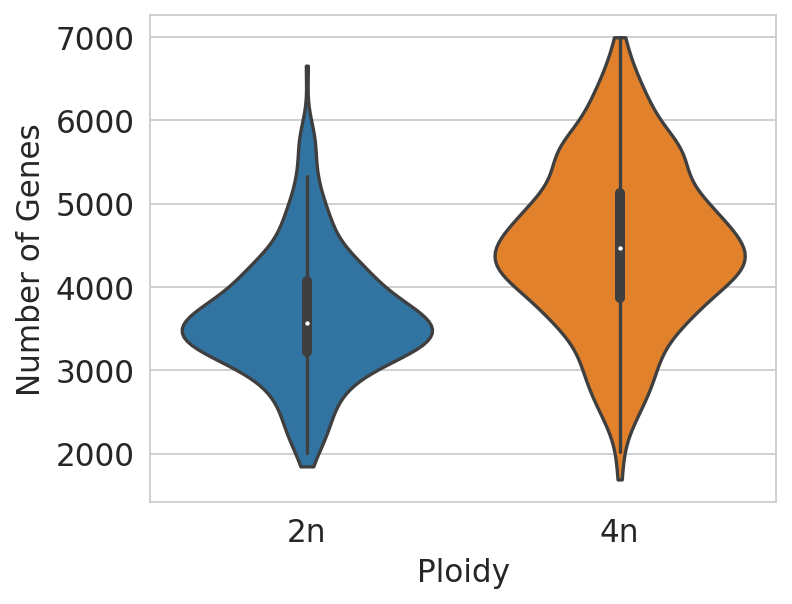

/home/icb/maren.buettner/anaconda3/envs/scanpy1-6/lib/python3.8/site-packages/seaborn/_decorators.py:36: FutureWarning: Pass the following variable as a keyword arg: x. From version 0.12, the only valid positional argument will be `data`, and passing other arguments without an explicit keyword will result in an error or misinterpretation.
  warnings.warn(


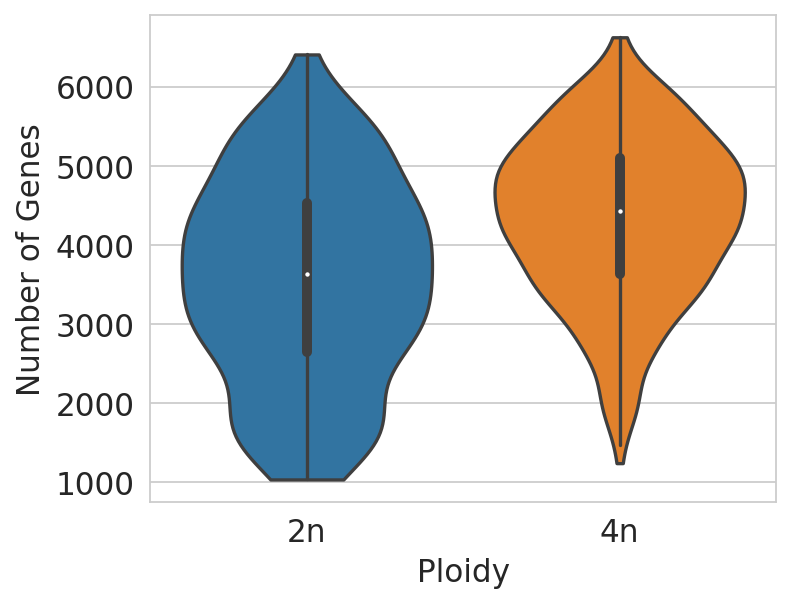

/home/icb/maren.buettner/anaconda3/envs/scanpy1-6/lib/python3.8/site-packages/seaborn/_decorators.py:36: FutureWarning: Pass the following variable as a keyword arg: x. From version 0.12, the only valid positional argument will be `data`, and passing other arguments without an explicit keyword will result in an error or misinterpretation.
  warnings.warn(


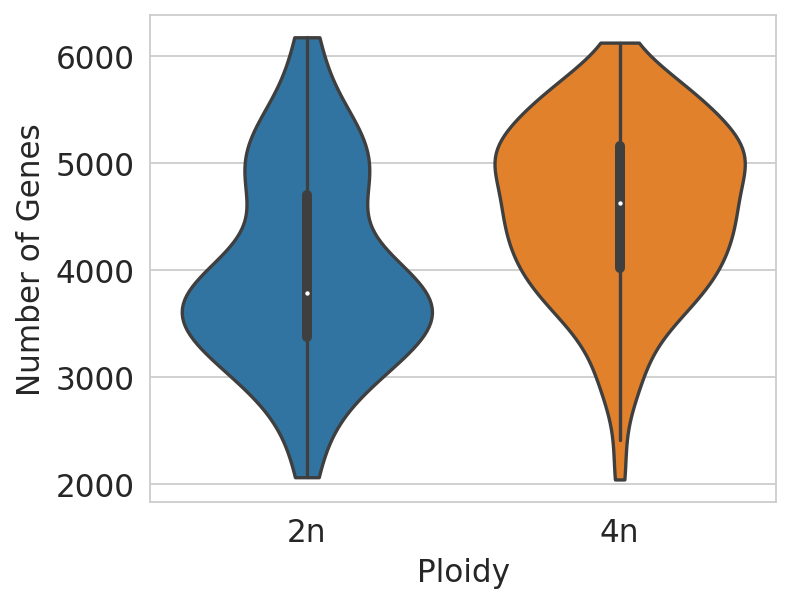

/home/icb/maren.buettner/anaconda3/envs/scanpy1-6/lib/python3.8/site-packages/seaborn/_decorators.py:36: FutureWarning: Pass the following variable as a keyword arg: x. From version 0.12, the only valid positional argument will be `data`, and passing other arguments without an explicit keyword will result in an error or misinterpretation.
  warnings.warn(


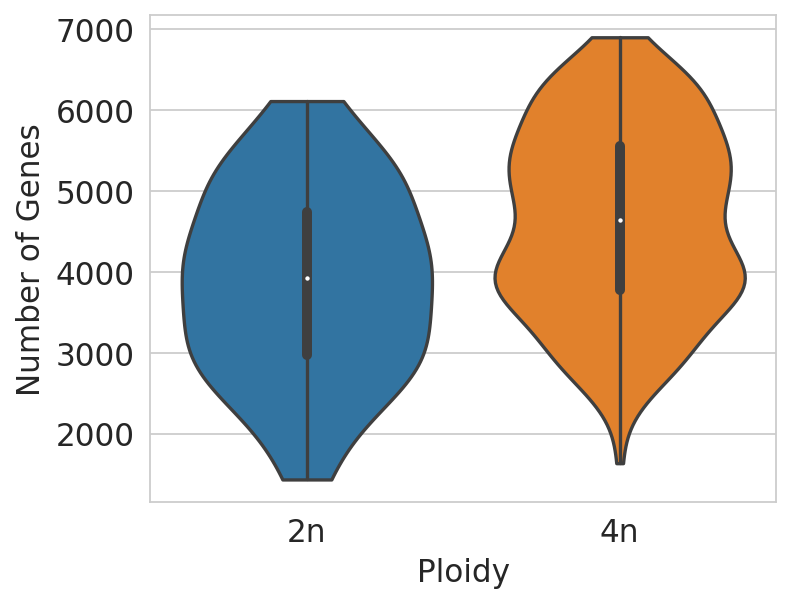

/home/icb/maren.buettner/anaconda3/envs/scanpy1-6/lib/python3.8/site-packages/seaborn/_decorators.py:36: FutureWarning: Pass the following variable as a keyword arg: x. From version 0.12, the only valid positional argument will be `data`, and passing other arguments without an explicit keyword will result in an error or misinterpretation.
  warnings.warn(


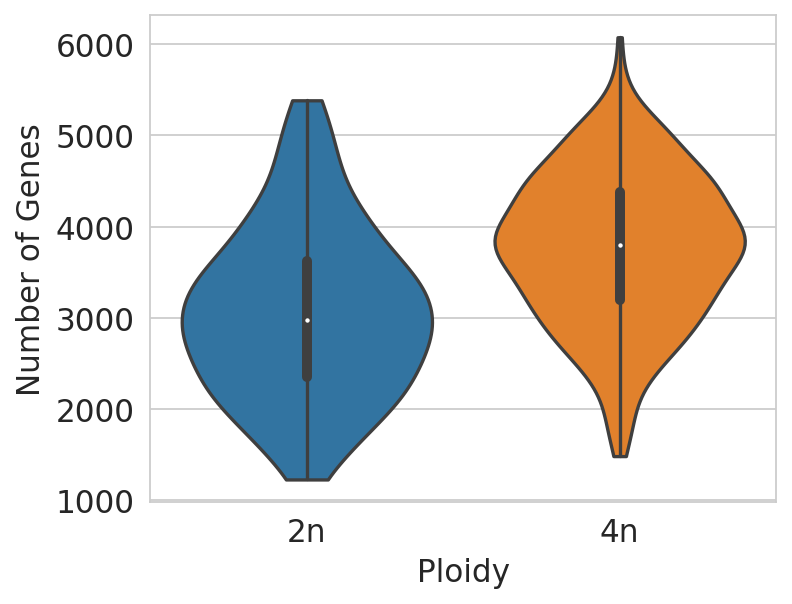

/home/icb/maren.buettner/anaconda3/envs/scanpy1-6/lib/python3.8/site-packages/seaborn/_decorators.py:36: FutureWarning: Pass the following variable as a keyword arg: x. From version 0.12, the only valid positional argument will be `data`, and passing other arguments without an explicit keyword will result in an error or misinterpretation.
  warnings.warn(


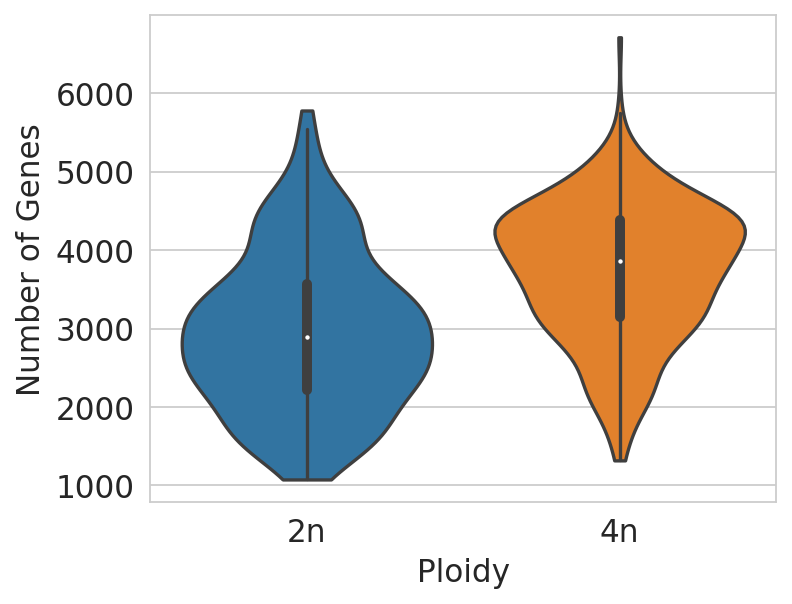

/home/icb/maren.buettner/anaconda3/envs/scanpy1-6/lib/python3.8/site-packages/seaborn/_decorators.py:36: FutureWarning: Pass the following variable as a keyword arg: x. From version 0.12, the only valid positional argument will be `data`, and passing other arguments without an explicit keyword will result in an error or misinterpretation.
  warnings.warn(


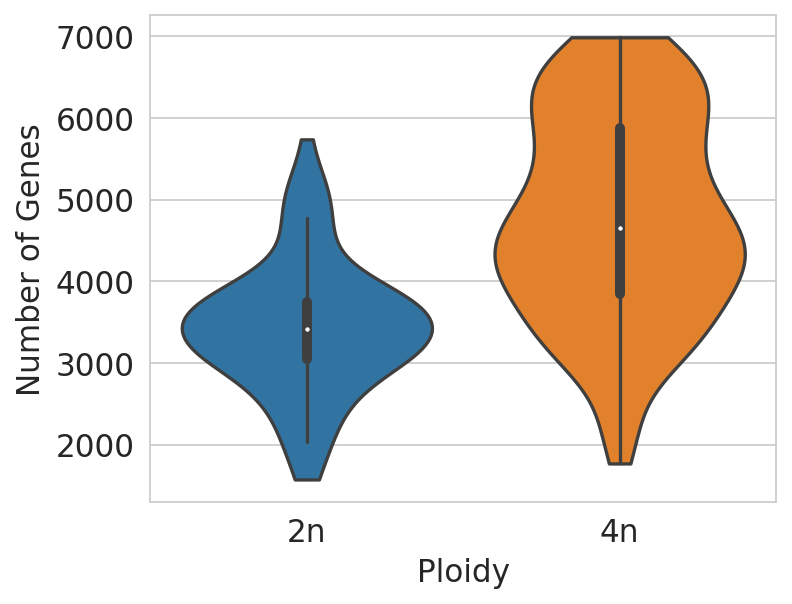

/home/icb/maren.buettner/anaconda3/envs/scanpy1-6/lib/python3.8/site-packages/seaborn/_decorators.py:36: FutureWarning: Pass the following variable as a keyword arg: x. From version 0.12, the only valid positional argument will be `data`, and passing other arguments without an explicit keyword will result in an error or misinterpretation.
  warnings.warn(


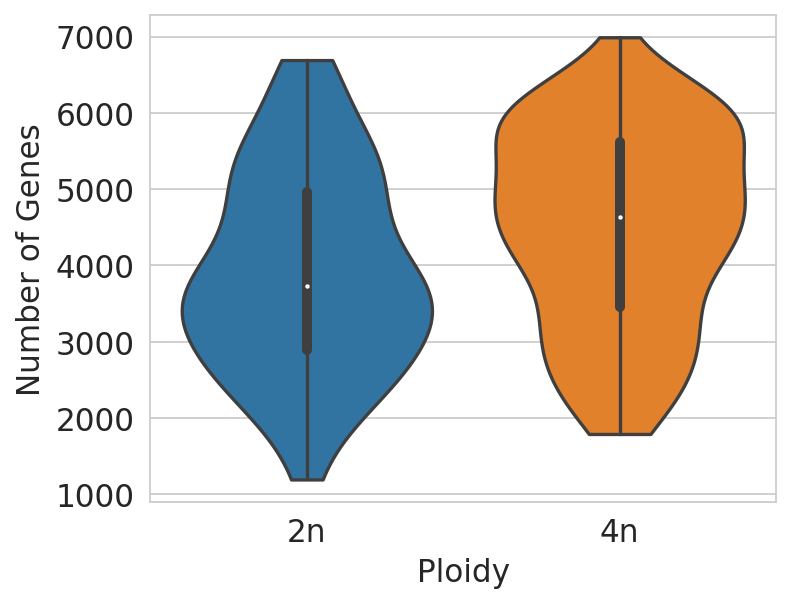

In [58]:
sns.set_style('whitegrid')
rcParams['figure.figsize']=(5,4)

adata_hep0 = adata_all[adata_all.obs['cell_type1']=='Hepatocytes'].copy()

for age2 in adata_hep0.obs['strain_age'].cat.categories:
    adata_tmp = adata_hep0[adata_hep0.obs['strain_age']==age2].copy()
    sc.pl.violin(adata_tmp, groupby = 'ploidy', keys = 'n_genes', 
             stripplot=False,
             ylabel='Number of Genes',
             xlabel = 'Ploidy',
                 title= 'Hepatocytes',
             **{'inner': 'box'},
             save = f"_{today}_genes_ploidy_hepatocytes_{age2.replace('/','')}.pdf"
            )

/home/icb/maren.buettner/anaconda3/envs/scanpy1-6/lib/python3.8/site-packages/seaborn/_decorators.py:36: FutureWarning: Pass the following variable as a keyword arg: x. From version 0.12, the only valid positional argument will be `data`, and passing other arguments without an explicit keyword will result in an error or misinterpretation.
  warnings.warn(


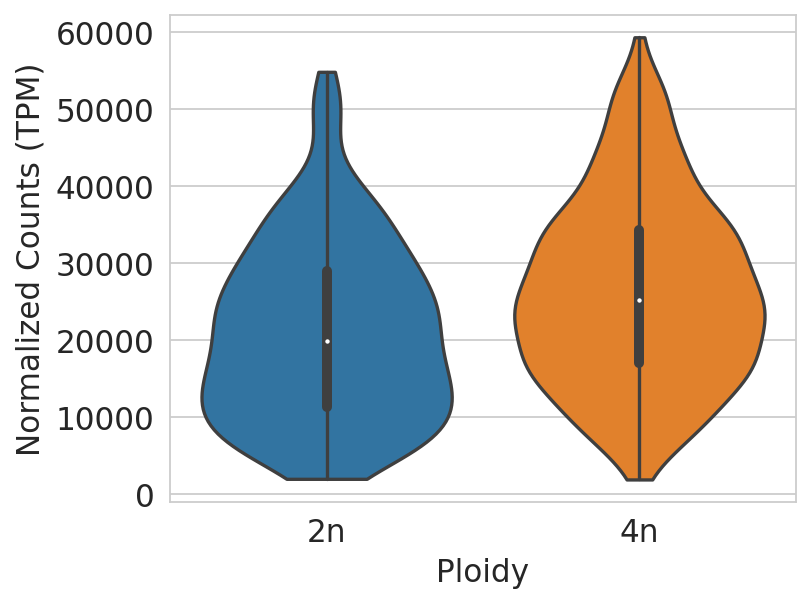

/home/icb/maren.buettner/anaconda3/envs/scanpy1-6/lib/python3.8/site-packages/seaborn/_decorators.py:36: FutureWarning: Pass the following variable as a keyword arg: x. From version 0.12, the only valid positional argument will be `data`, and passing other arguments without an explicit keyword will result in an error or misinterpretation.
  warnings.warn(


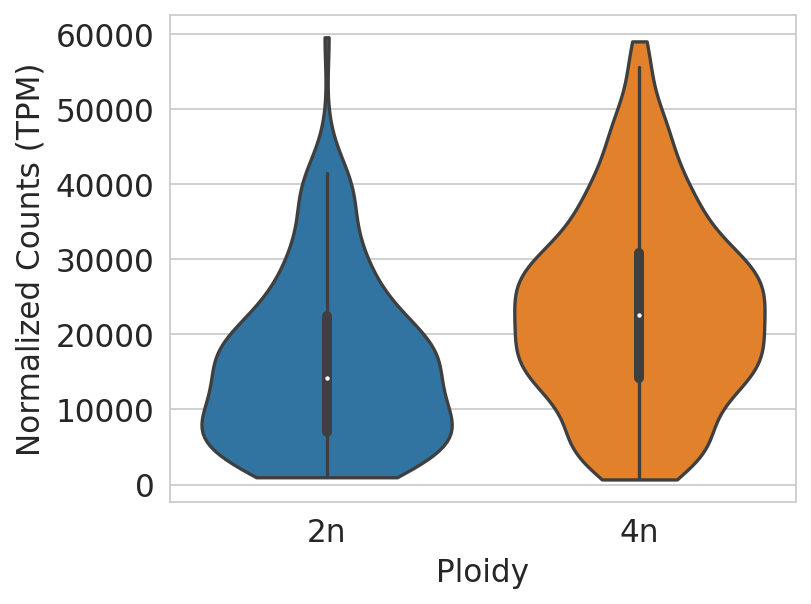

/home/icb/maren.buettner/anaconda3/envs/scanpy1-6/lib/python3.8/site-packages/seaborn/_decorators.py:36: FutureWarning: Pass the following variable as a keyword arg: x. From version 0.12, the only valid positional argument will be `data`, and passing other arguments without an explicit keyword will result in an error or misinterpretation.
  warnings.warn(


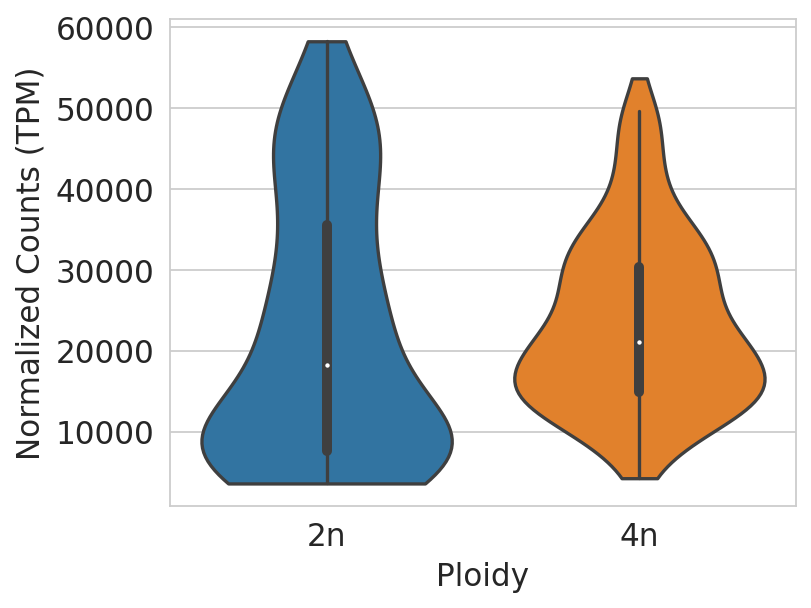

/home/icb/maren.buettner/anaconda3/envs/scanpy1-6/lib/python3.8/site-packages/seaborn/_decorators.py:36: FutureWarning: Pass the following variable as a keyword arg: x. From version 0.12, the only valid positional argument will be `data`, and passing other arguments without an explicit keyword will result in an error or misinterpretation.
  warnings.warn(


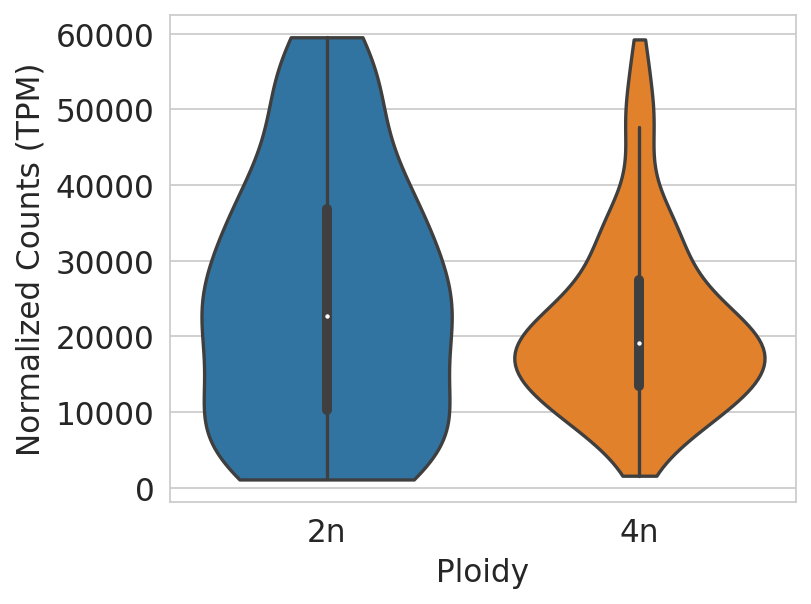

/home/icb/maren.buettner/anaconda3/envs/scanpy1-6/lib/python3.8/site-packages/seaborn/_decorators.py:36: FutureWarning: Pass the following variable as a keyword arg: x. From version 0.12, the only valid positional argument will be `data`, and passing other arguments without an explicit keyword will result in an error or misinterpretation.
  warnings.warn(


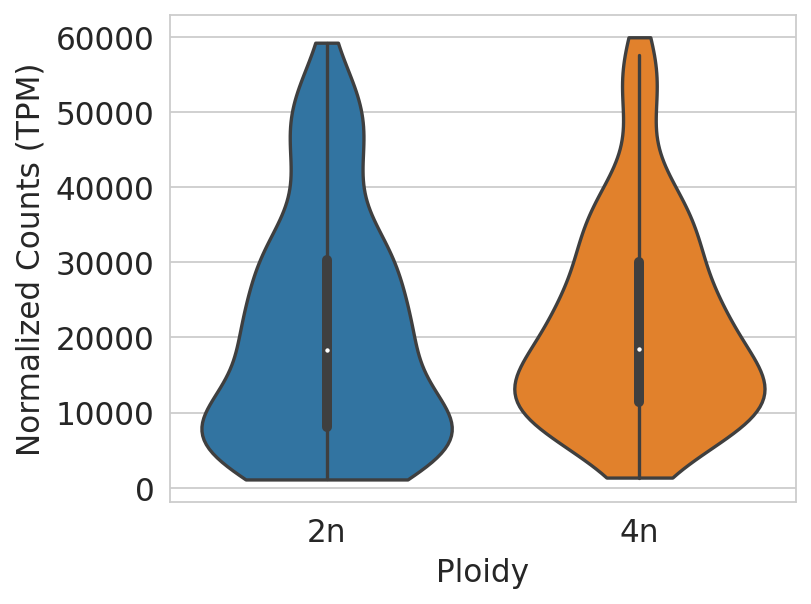

/home/icb/maren.buettner/anaconda3/envs/scanpy1-6/lib/python3.8/site-packages/seaborn/_decorators.py:36: FutureWarning: Pass the following variable as a keyword arg: x. From version 0.12, the only valid positional argument will be `data`, and passing other arguments without an explicit keyword will result in an error or misinterpretation.
  warnings.warn(


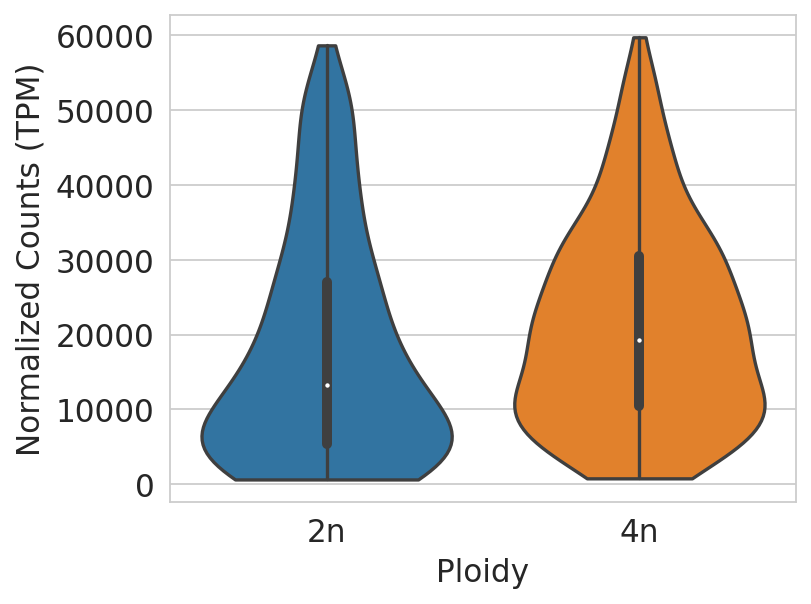

/home/icb/maren.buettner/anaconda3/envs/scanpy1-6/lib/python3.8/site-packages/seaborn/_decorators.py:36: FutureWarning: Pass the following variable as a keyword arg: x. From version 0.12, the only valid positional argument will be `data`, and passing other arguments without an explicit keyword will result in an error or misinterpretation.
  warnings.warn(


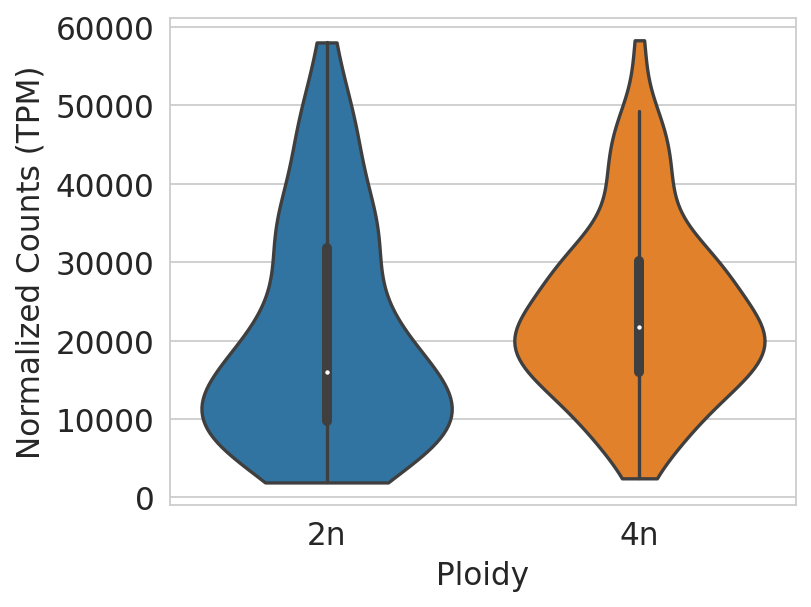

/home/icb/maren.buettner/anaconda3/envs/scanpy1-6/lib/python3.8/site-packages/seaborn/_decorators.py:36: FutureWarning: Pass the following variable as a keyword arg: x. From version 0.12, the only valid positional argument will be `data`, and passing other arguments without an explicit keyword will result in an error or misinterpretation.
  warnings.warn(


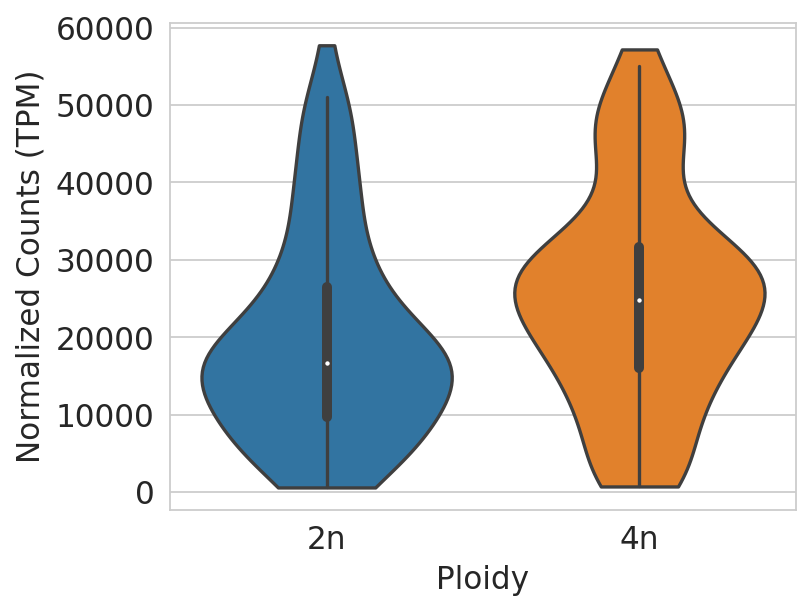

In [71]:
sns.set_style('whitegrid')
rcParams['figure.figsize']=(5,4)

adata_hep0 = adata_all[adata_all.obs['cell_type1']=='Hepatocytes'].copy()

for age2 in adata_hep0.obs['strain_age'].cat.categories:
    adata_tmp = adata_hep0[adata_hep0.obs['strain_age']==age2].copy()
    sc.pl.violin(adata_tmp, groupby = 'ploidy', keys = 'n_counts_TPM', 
             stripplot=False,
             ylabel='Normalized Counts (TPM)',
             xlabel = 'Ploidy',
                 title= 'Hepatocytes',
             **{'inner': 'box'},
             save = f"_{today}_counts_ploidy_hepatocytes_{age2.replace('/','')}.pdf"
            )

In addition, we compute the mean RNA count 

* for all cells 
* for hepatocytes separated by ploidy

per strain and age.

In [64]:
df_count = adata_all.obs[['n_genes','n_counts_TPM', 'n_counts_TPM_norm', 
                          'strain_age', 'ploidy', 'cell_type1']]

In [66]:
df_mean = df_count.groupby(['strain_age']).mean()

In [67]:
df_mean.to_csv(f"./../tables/{today}_summary_genes_counts_all_cells.csv")

Single out hepatocytes. 

In [64]:
df_count = adata_hep.obs[['n_genes','n_counts_TPM', 'n_counts_TPM_norm', 
                          'strain_age', 'ploidy', 'cell_type1']]

In [68]:
df_mean = df_count.groupby(['strain_age', 'ploidy']).mean()

In [70]:
df_mean.to_csv(f"./../tables/{today}_summary_genes_counts_hepatocytes.csv")

# Visualise embedding

## All cells

In [28]:
sc.pp.pca(adata_all)
sc.pp.neighbors(adata_all)
sc.tl.tsne(adata_all, perplexity=30, n_pcs=15)

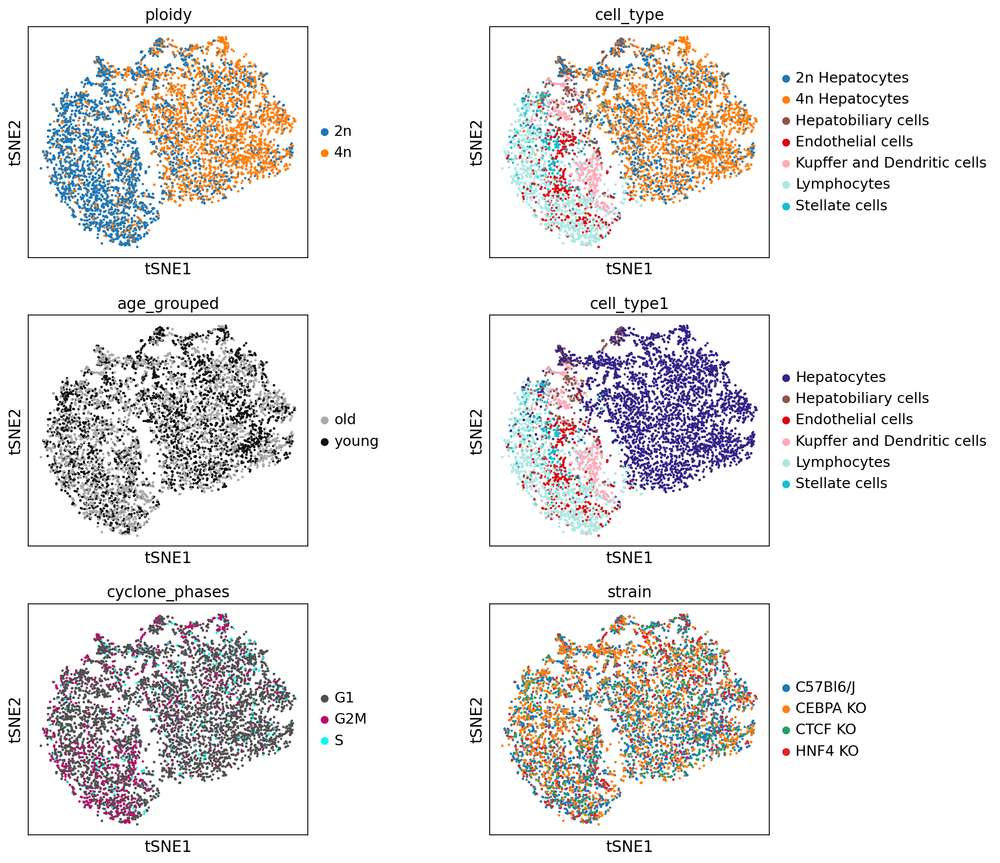

In [31]:
sc.pl.tsne(adata_all, 
           color=['ploidy','cell_type','age_grouped',
                  'cell_type1','cyclone_phases', 'strain'], 
           ncols=2, wspace=0.5,
           save= today + '_all_overview.pdf'
          )

Plot the following things on a t-SNE:
* % of ERCC reads, 
* raw transcript counts, 
* normalised counts, 
* normalisation scoring for individual SNIs

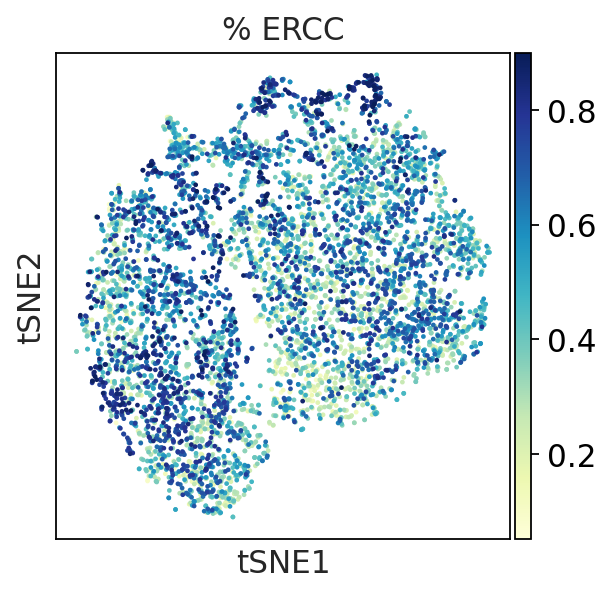

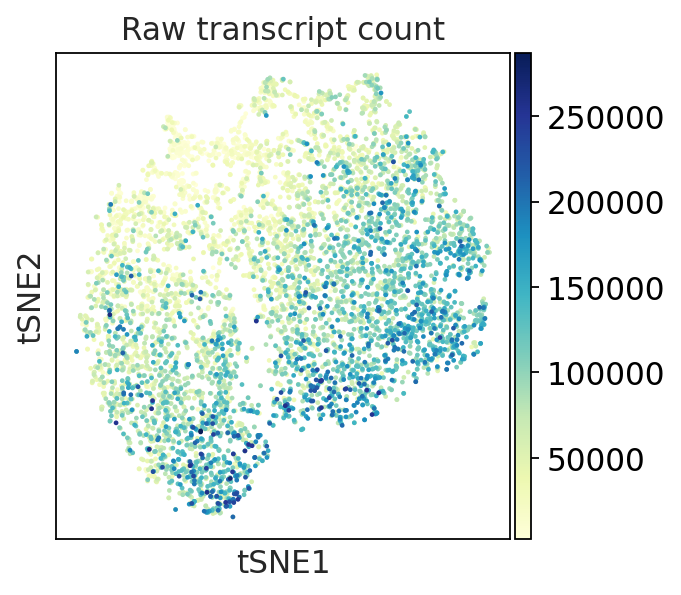

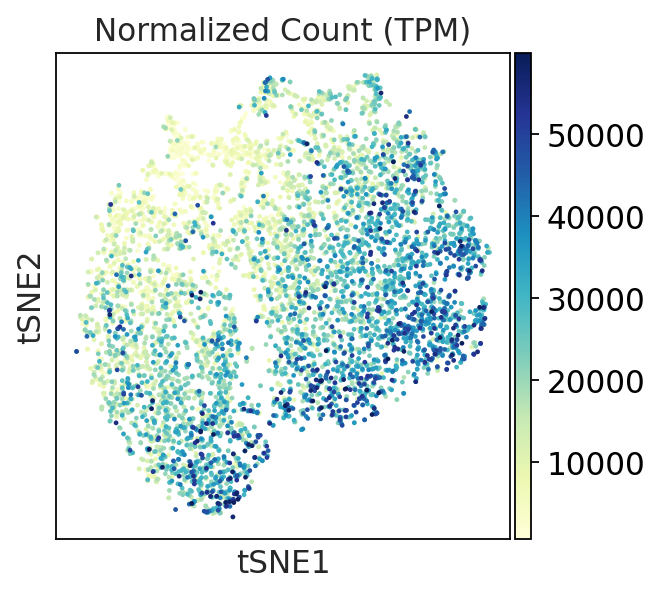

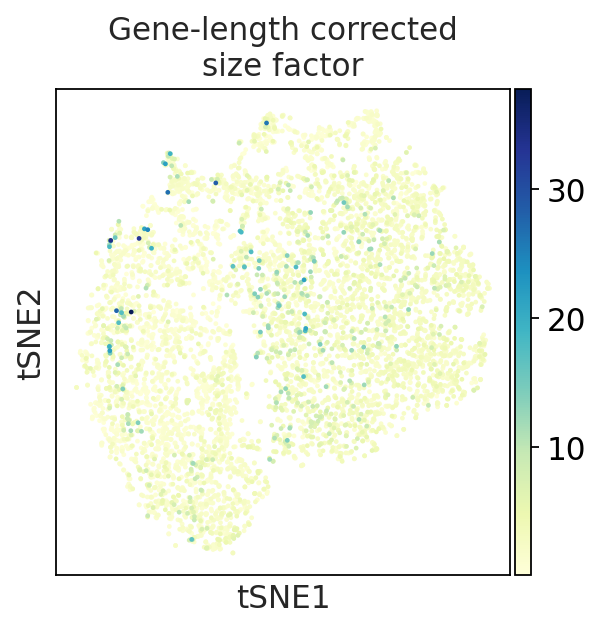

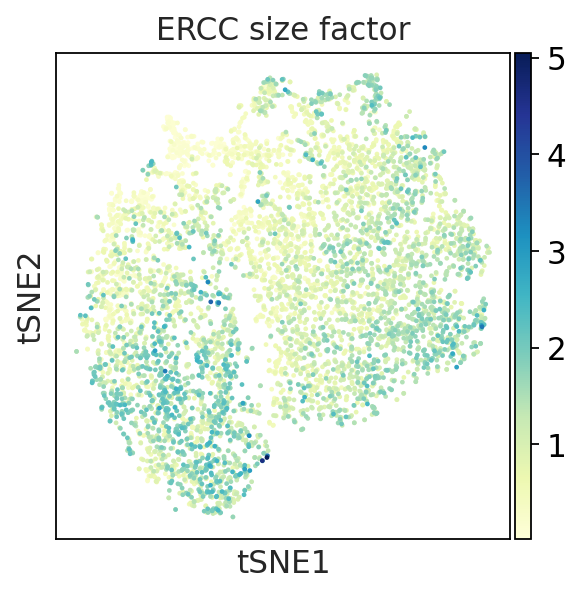

In [86]:
title_dict = {
    'percentERCC': "% ERCC",
    'n_counts_transcripts': 'Raw transcript count', 
    'n_counts_TPM': "Normalized Count (TPM)", 
    "RPK_factor": "Gene-length corrected\nsize factor",
    'ERCC_size_factor': "ERCC size factor",
}


rcParams['figure.figsize']=(4,4)
for key in title_dict:

    sc.pl.tsne(adata_all, 
           color=key,
           ncols=2, wspace=0.5,
               title= title_dict[key],
           save= f"{today}_all_cells_{key}.pdf"
          )

## Wild type young and old

In [24]:
   
sc.pp.pca(adata_wt_young)
sc.pp.neighbors(adata_wt_young)
sc.tl.tsne(adata_wt_young, perplexity=30, n_pcs=15)

In [25]:
sc.pp.pca(adata_wt_old)
sc.pp.neighbors(adata_wt_old)
sc.tl.tsne(adata_wt_old, perplexity=30, n_pcs=15)

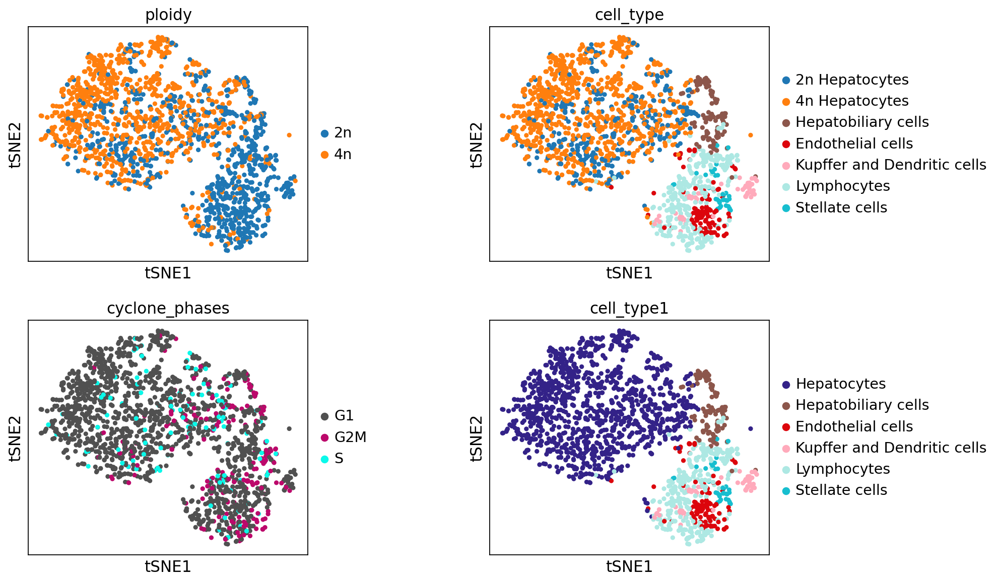

In [28]:
sc.pl.tsne(adata_wt_young, color=['ploidy','cell_type','cyclone_phases','cell_type1'], 
           ncols=2, wspace=0.5,
           save= today + 'young_C57Bl6J_overview.pdf'
          )

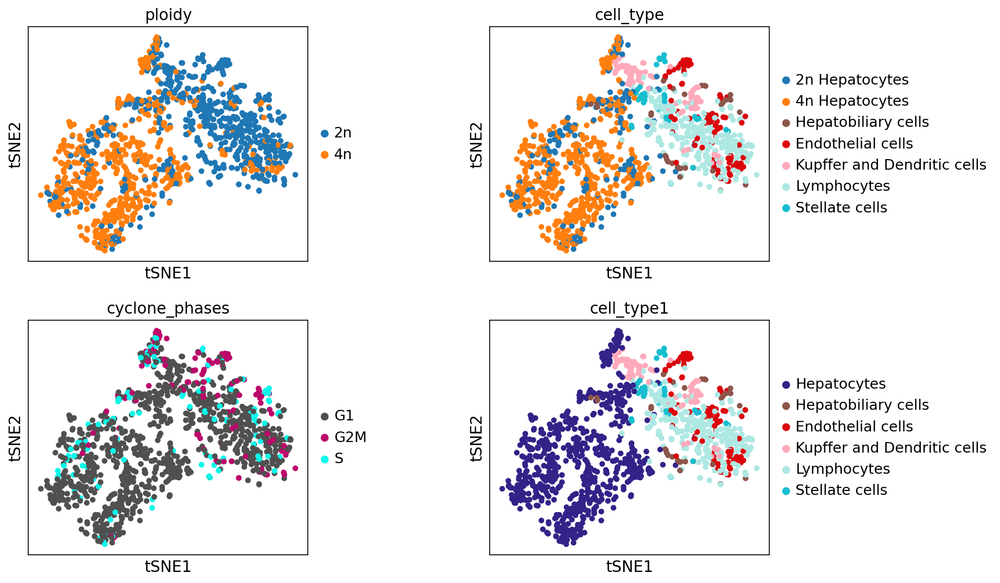

In [29]:
sc.pl.tsne(adata_wt_old, color=['ploidy','cell_type','cyclone_phases','cell_type1'], ncols=2, wspace=0.5,
           save= today + 'old_C57Bl6J_overview.pdf'
          )

## Per strain

Fig. 1A: t-SNE plot showing wild type

- low resolution leiden clustering
- age
- ploidy
- cell type
- cell cycle phase
- ploidy + cell type

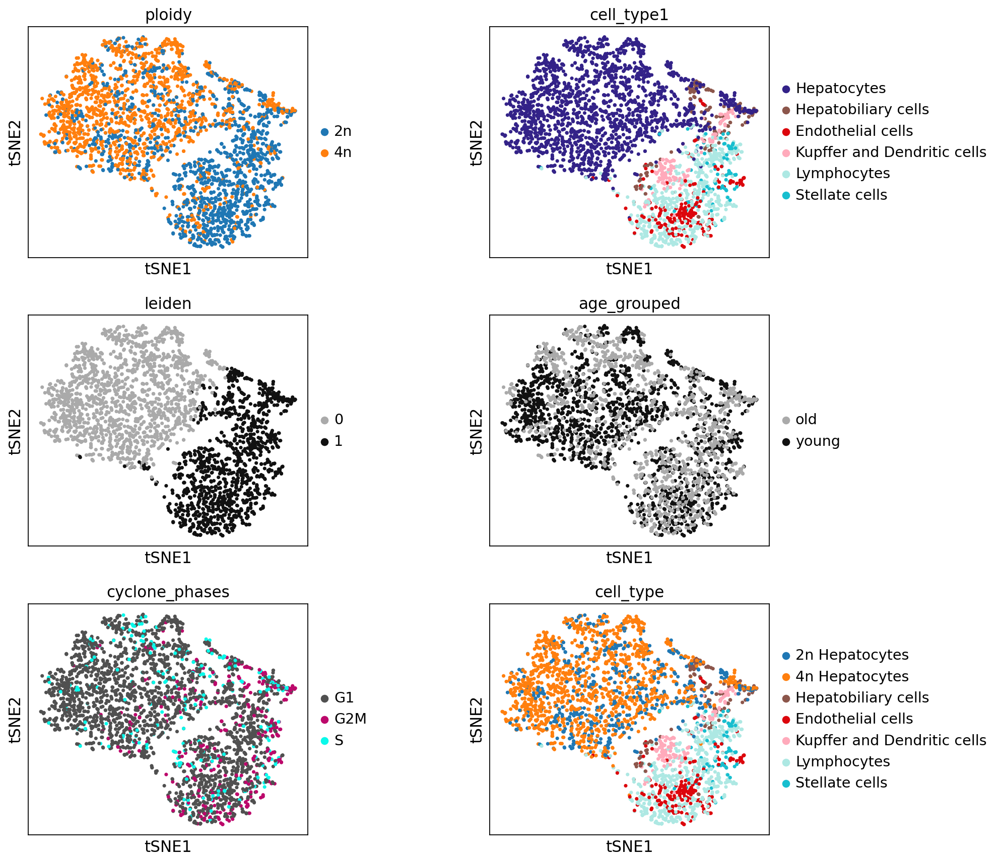

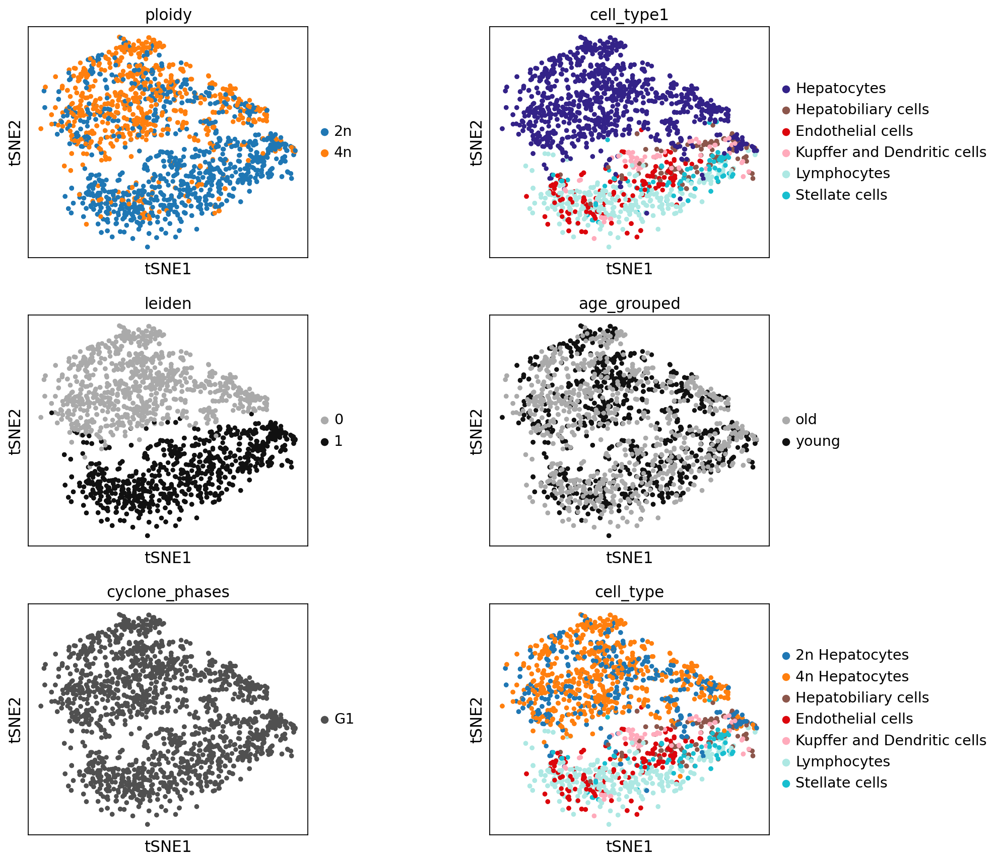

In [ ]:
for strain in adata_all.obs['strain'].cat.categories:
    adata_strain = adata_all[adata_all.obs['strain'].isin([strain])].copy()
    sc.pp.pca(adata_strain)
    sc.pp.neighbors(adata_strain)
    sc.tl.tsne(adata_strain, perplexity=30, n_pcs=15)
    sc.tl.leiden(adata_strain, resolution = 0.2)
    
    sc.pl.tsne(adata_strain, color=['ploidy','cell_type1', 'leiden',
                                    'age_grouped','cyclone_phases','cell_type'], 
               ncols=2, wspace=0.5,
           save= today + '_' + strain.replace('/','') + '_overview.pdf'
          )

# Create violin plot

Plot some genes of interest.

In [29]:
genes_oi = np.array(['Hmox1','Csf3','Csf2','Il1b','Il3','Il10','Csf1',
            'Thpo','Kit','Tgfb1','Tgfb2','Cxcl12',
            'Ifna1','Ifna2','Erfe','Trf'])

In [31]:
genes_present = genes_oi[np.in1d(genes_oi, adata_wty.var_names)] 

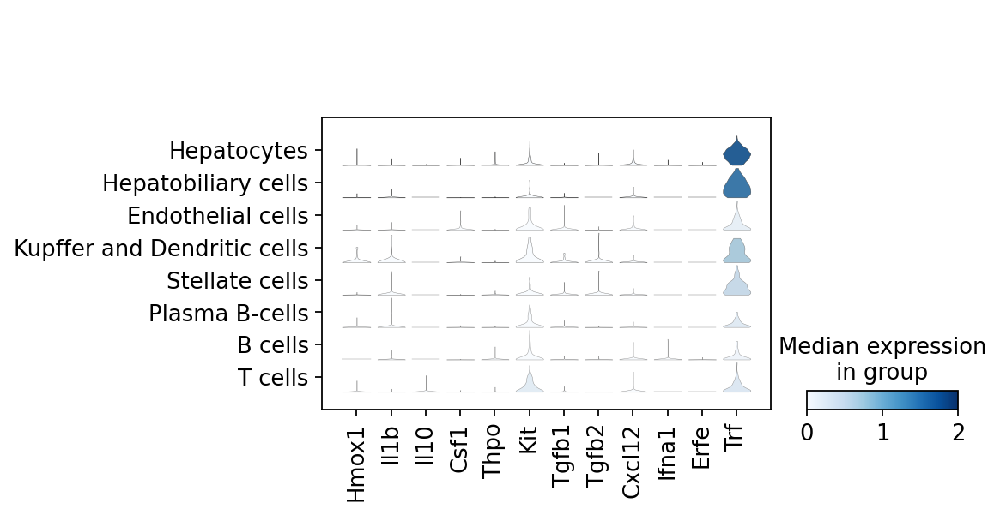

In [33]:
sc.pl.stacked_violin(adata_wty, vmax=2,
                     var_names=genes_present, groupby='cell_type1',
                     save=today + '_C56Bl6J_young_cell-type.pdf'
                    )

# Heatmap of differentially expressed genes in hepatocytes

In this section, we aim to visualise hepatocyte-specific genes in the hepatocytes. Specifically, we group the hepatocytes by strain and age. 

In [29]:
adata_hep = adata[adata.obs['cell_type1']=='Hepatocytes'].copy()

In [30]:
adata_hep

AnnData object with n_obs × n_vars = 3951 × 30520
    obs: 'batch', 'exp.', 'libraryID', 'experiment', 'strain', 'age', 'sex', 'ploidy', 'ERCC.dilution', 'column', 'row', 'percentERCC', 'n_counts', 'age_grouped', 'n_counts_raw', 'n_counts_transcripts', 'n_counts_ERCC', 'n_genes', 'high_ERCC', 'low_ERCC', 'low_genes', 'high_genes', 'low_counts', 'high_counts', 'ERCC_size_factor', 'n_counts_TPM', 'RPK_factor', 'n_counts_TPM_norm', 'mean_transcript_count_TPM', 'cyclone_phases', 'score_G1', 'score_S', 'score_G2M', 'cell_type', 'cell_type1', 'leiden_r1', 'leiden_r02', 'low_res_ct', 'clusters', 'score_Cholangiocyte', 'score_Endothelial', 'score_Lymphocyte', 'score_Kupffer and Macrophage', 'score_Hepatoblast', 'score_Natural killer', 'score_Neutrophil', 'score_B cells', 'score_Dendritic cell', 'score_Hepatocyte', 'leidenr02_02', 'hblast_marker_sum', 'ploidy_age', 'prelim_anno', 'strain_age'
    var: 'length', 'chromosomes', 'start', 'end', 'n_counts', 'mean_exp_TPM', 'median_exp_TPM'
    uns:

Read in genes of interest for the heatmaps.

In [82]:
files = os.listdir(data_dir)

files_hm = [fileID for fileID in files if fileID.startswith('Heatmap')]

In [83]:
heatmap_marker_dict = {}

for fileID in files_hm:
    key = fileID.split('Heatmap_genes_')[1].split('.csv')[0]
    tmp = pd.read_csv(data_dir + fileID, sep=';', index_col=None)
    heatmap_marker_dict[key] = tmp

In [78]:
heatmap_marker_dict.keys()

dict_keys(['young_ctcf_overlap', 'old_liver_specific', 'old_wt_overlap', 'young_liver_specific', 'young_wt', 'old_ctcf_overlap', 'young_wt_overlap', 'old_wt'])

In [96]:
heatmap_marker_dict['young_wt_overlap'].rename(columns={"Genes": "Gene", "Upreg in young": "Upreg in young"}, inplace=True)

young_ctcf_overlap


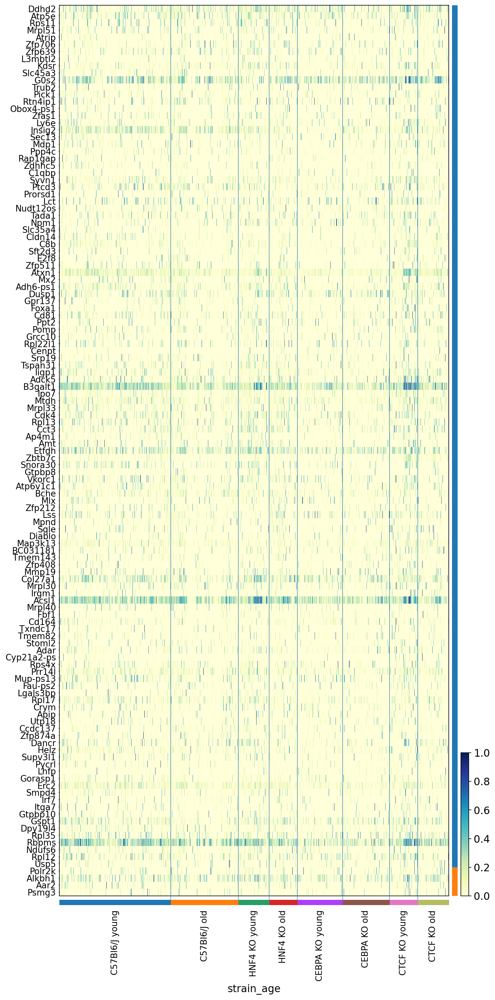

old_liver_specific


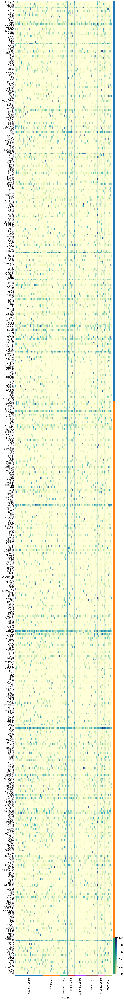

old_wt_overlap


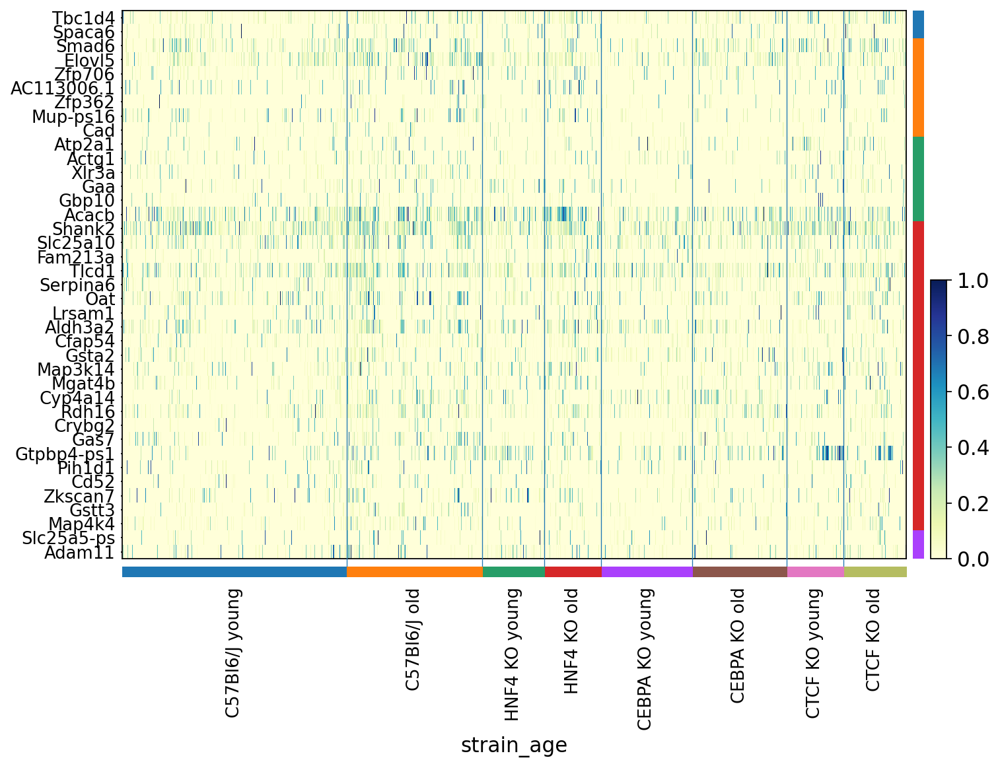

young_liver_specific


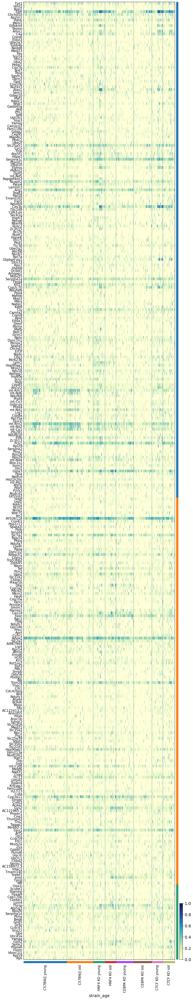

young_wt


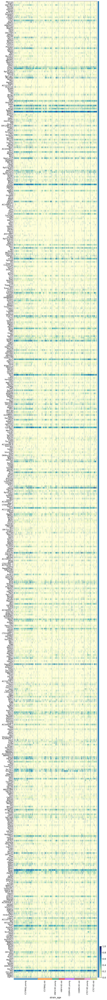

old_ctcf_overlap


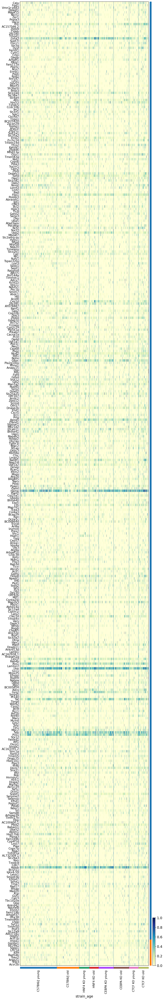

young_wt_overlap


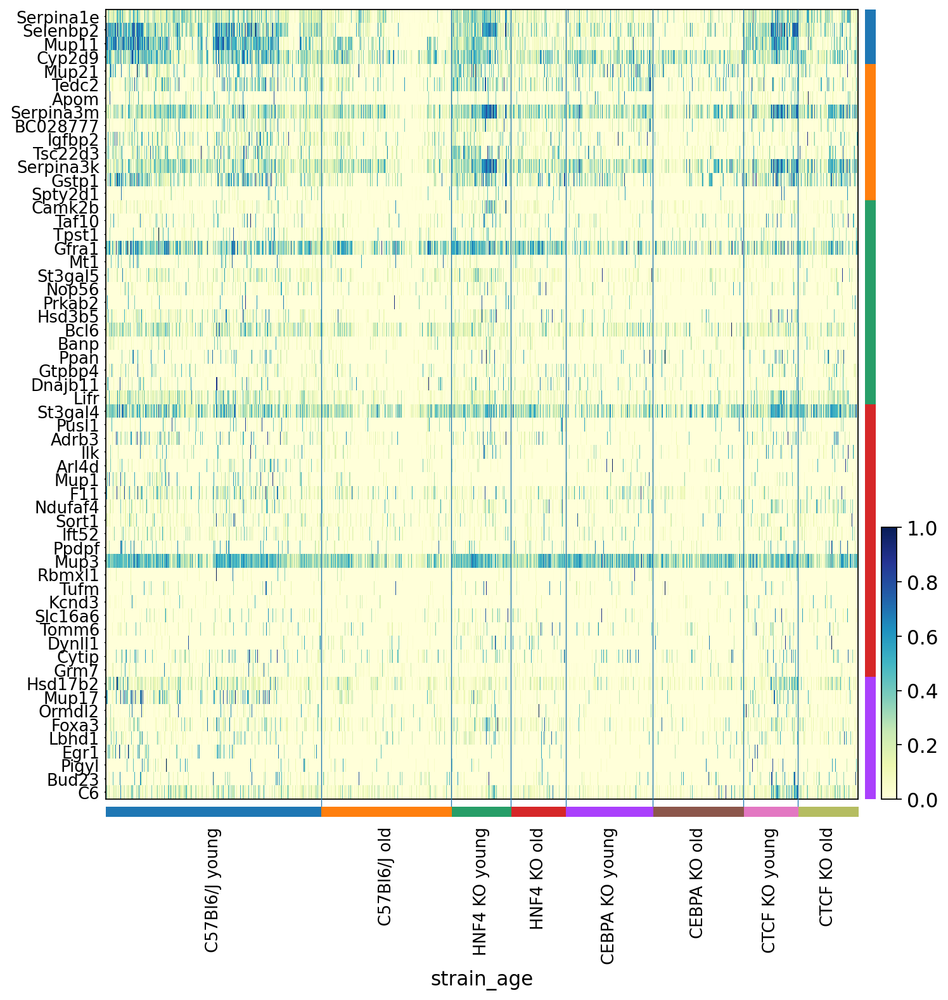

old_wt


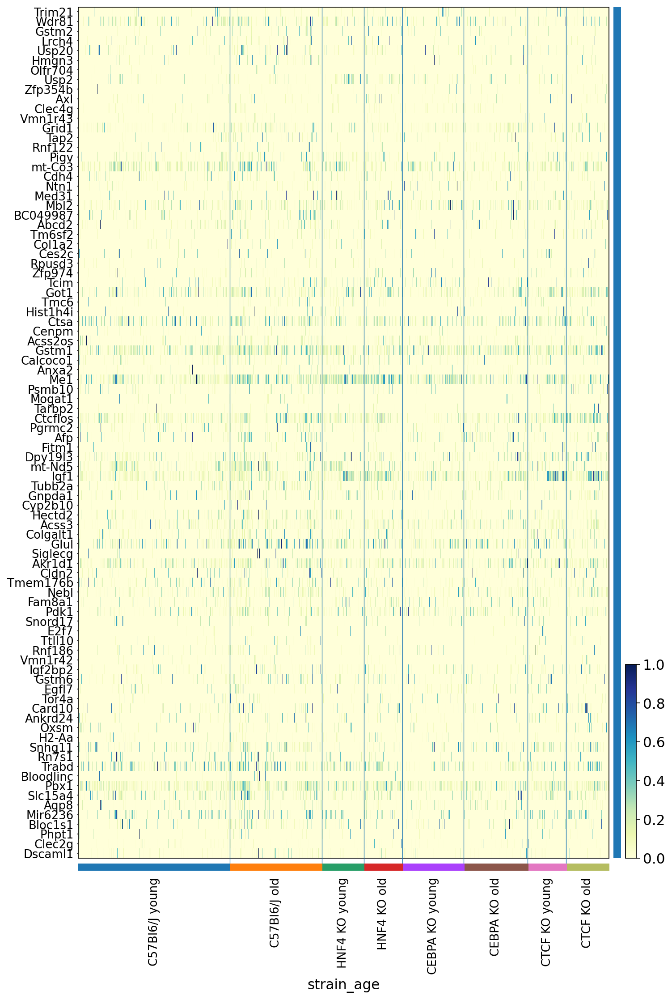

In [98]:
for key in heatmap_marker_dict.keys():
    print(key)
    #obtain unique groups
    var_group = heatmap_marker_dict[key].iloc[:,1]
    var_group_names = np.unique(var_group)
    var_group_pos = []
    for names in var_group_names:
        #get indices
        idx = np.where(var_group == names)[0]
        var_group_pos.append((idx[0],idx[-1]))
        
    sc.pl.heatmap(adata_hep, var_names=heatmap_marker_dict[key]['Gene'], standard_scale='var',
                  var_group_positions = var_group_pos, var_group_labels=var_group_names,
                  groupby = 'strain_age', cmap='YlGnBu', show_gene_labels=True, swap_axes=True, 
                  save = '_' + today + '_' + key + '_hepatocytes_strain_age.pdf'
                 )

Filter out lowly expressed genes. 

In [121]:
adata_hep.var['gene_mean'] = adata_hep.X.mean(axis=0)

In [123]:
adata_hep = adata_hep[:,adata_hep.var['gene_mean']>0.05]

young_ctcf_overlap
118


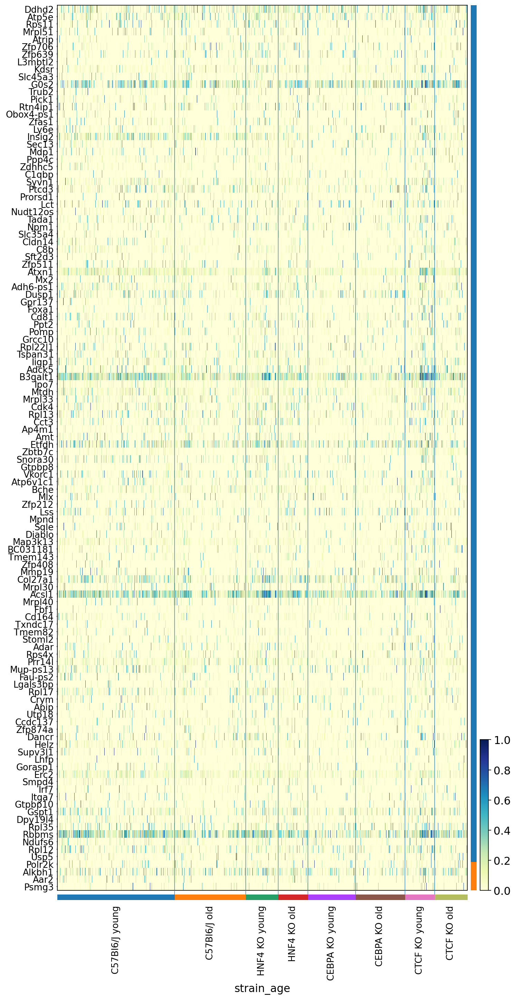

old_liver_specific
518


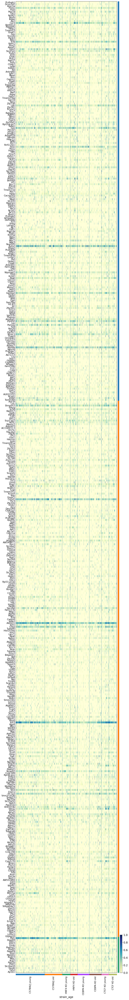

old_wt_overlap
39


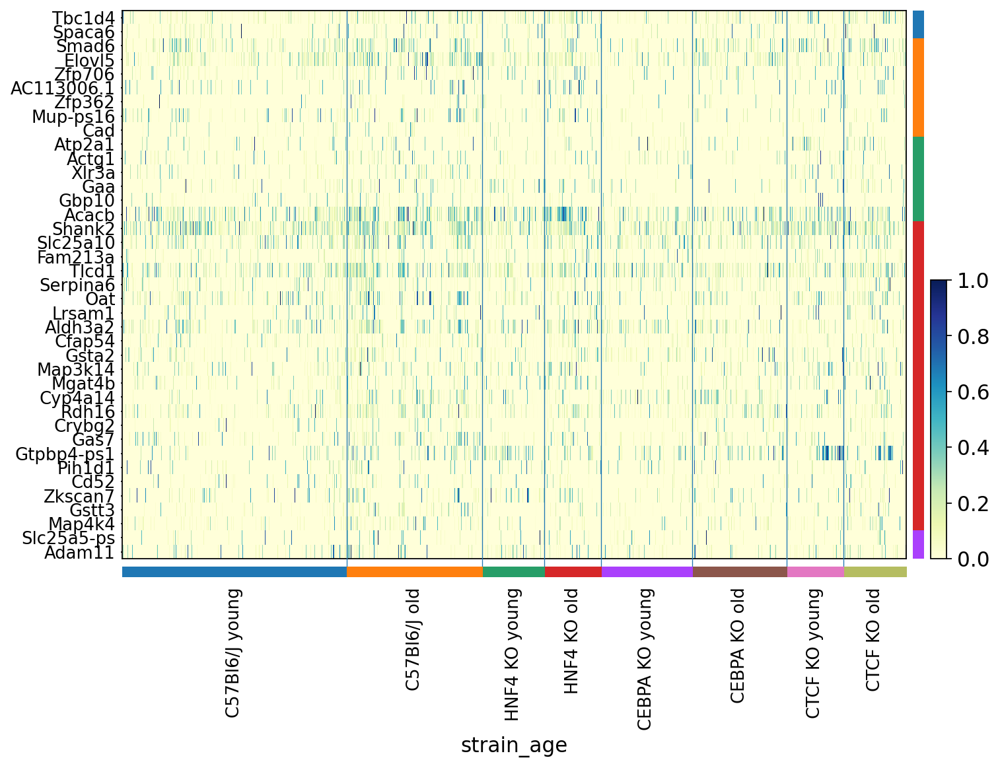

young_liver_specific
339


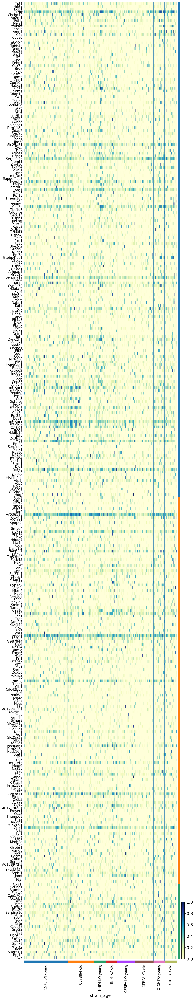

young_wt
513


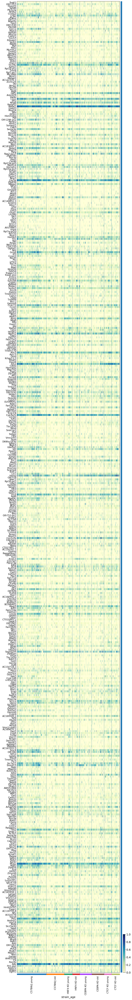

old_ctcf_overlap
385


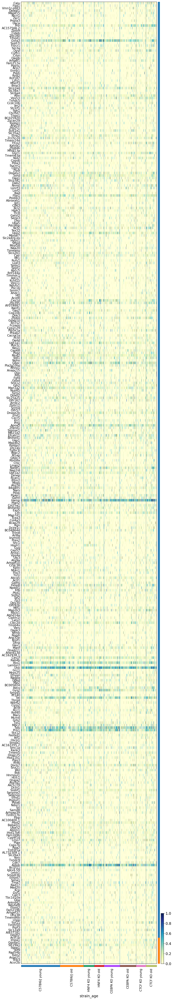

young_wt_overlap
57


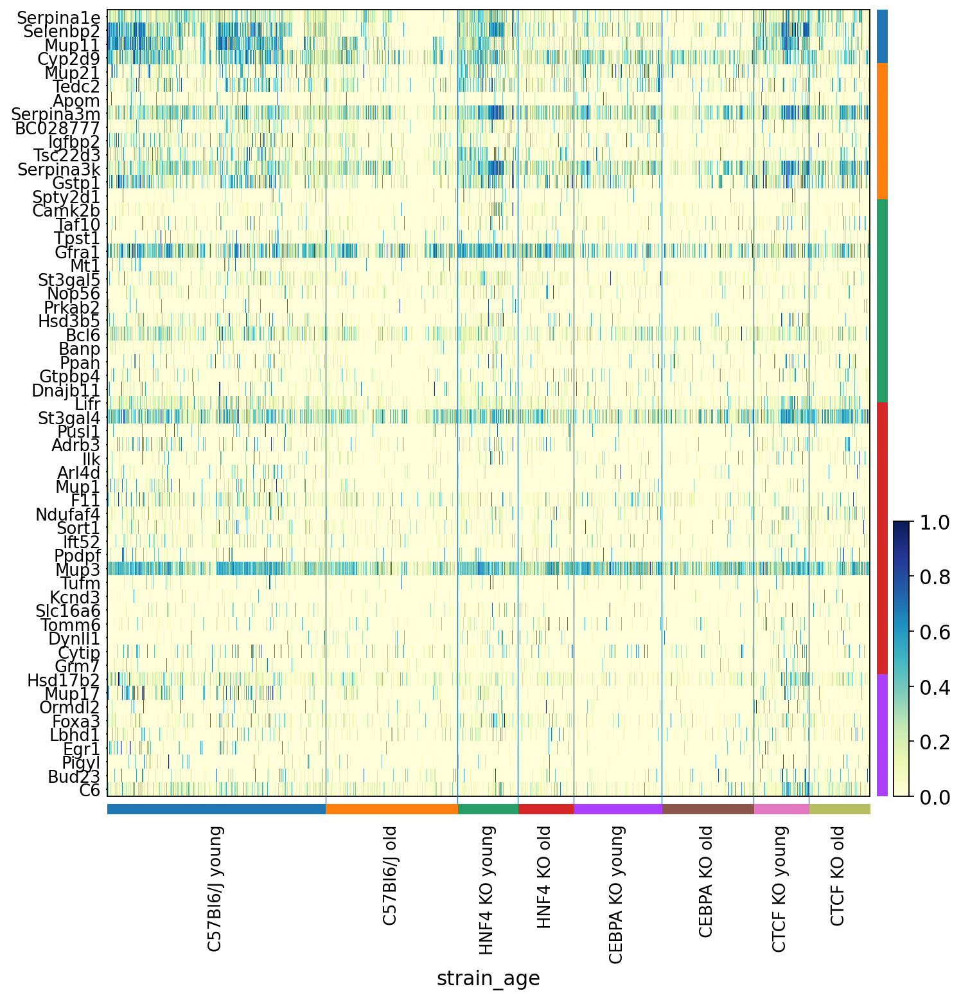

old_wt
59


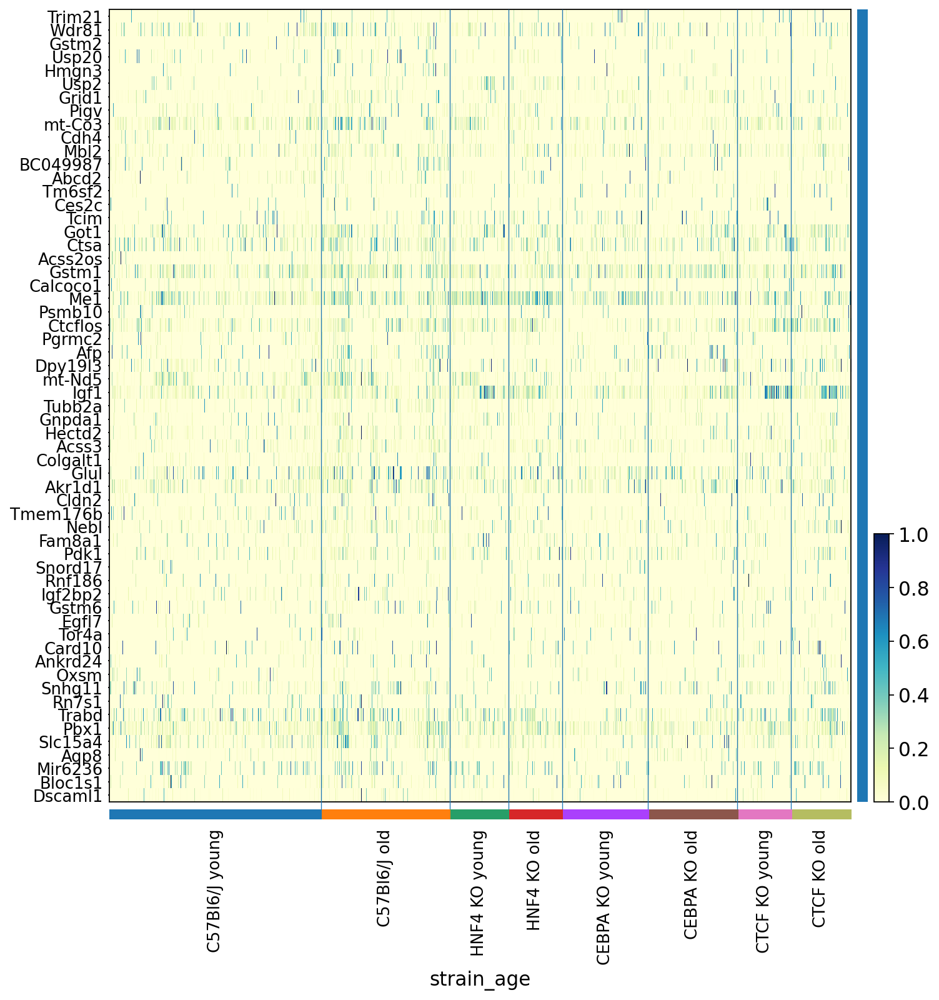

In [126]:
for key in heatmap_marker_dict.keys():
    print(key)
    #obtain unique groups
    var_group = heatmap_marker_dict[key].iloc[:,1]
    var_group_names = np.unique(var_group)
    var_group_pos = []
    for names in var_group_names:
        #get indices
        idx = np.where(var_group == names)[0]
        var_group_pos.append((idx[0],idx[-1]))
    genes_oi = heatmap_marker_dict[key]['Gene']
    genes_oi = genes_oi[np.in1d(genes_oi, adata_hep.var_names)]
    print(len(genes_oi))    
    sc.pl.heatmap(adata_hep, var_names=genes_oi, standard_scale='var',
                  var_group_positions = var_group_pos, var_group_labels=var_group_names,
                  groupby = 'strain_age', cmap='YlGnBu', show_gene_labels=True, swap_axes=True, 
                  save = '_' + today + '_' + key + '_hepatocytes_strain_age_mean0-05.pdf'
                 )

In [127]:
adata_hep = adata_hep[:,adata_hep.var['gene_mean']>0.2]
for key in heatmap_marker_dict.keys():
    print(key)
    #obtain unique groups
    var_group = heatmap_marker_dict[key].iloc[:,1]
    var_group_names = np.unique(var_group)
    var_group_pos = []
    for names in var_group_names:
        #get indices
        idx = np.where(var_group == names)[0]
        var_group_pos.append((idx[0],idx[-1]))
    genes_oi = heatmap_marker_dict[key]['Gene']
    genes_oi = genes_oi[np.in1d(genes_oi, adata_hep.var_names)]
    print(len(genes_oi))    
    sc.pl.heatmap(adata_hep, var_names=genes_oi, standard_scale='var',
                  var_group_positions = var_group_pos, var_group_labels=var_group_names,
                  groupby = 'strain_age', cmap='YlGnBu', show_gene_labels=True, swap_axes=True, 
                  save = '_' + today + '_' + key + '_hepatocytes_strain_age_mean0-2.pdf',show=False
                 )

young_ctcf_overlap
19
old_liver_specific
159
old_wt_overlap
8
young_liver_specific
121
young_wt
235
old_ctcf_overlap
115
young_wt_overlap
21
old_wt
9


In [128]:
adata_hep = adata_hep[:,adata_hep.var['gene_mean']>0.5]
for key in heatmap_marker_dict.keys():
    print(key)
    #obtain unique groups
    var_group = heatmap_marker_dict[key].iloc[:,1]
    var_group_names = np.unique(var_group)
    var_group_pos = []
    for names in var_group_names:
        #get indices
        idx = np.where(var_group == names)[0]
        var_group_pos.append((idx[0],idx[-1]))
    genes_oi = heatmap_marker_dict[key]['Gene']
    genes_oi = genes_oi[np.in1d(genes_oi, adata_hep.var_names)]
    print(len(genes_oi))    
    sc.pl.heatmap(adata_hep, var_names=genes_oi, standard_scale='var',
                  var_group_positions = var_group_pos, var_group_labels=var_group_names,
                  groupby = 'strain_age', cmap='YlGnBu', show_gene_labels=True, swap_axes=True, 
                  save = '_' + today + '_' + key + '_hepatocytes_strain_age_mean0-5.pdf',show=False
                 )

young_ctcf_overlap
5
old_liver_specific
36
old_wt_overlap
2
young_liver_specific
37
young_wt
123
old_ctcf_overlap
20
young_wt_overlap
10
old_wt
0


/home/icb/maren.buettner/anaconda3/envs/scanpy1-6/lib/python3.8/site-packages/scanpy/plotting/_anndata.py:1178: UserWarning: Attempting to set identical bottom == top == -0.5 results in singular transformations; automatically expanding.
  im = heatmap_ax.imshow(obs_tidy.T.values, aspect='auto', **kwds)
/home/icb/maren.buettner/anaconda3/envs/scanpy1-6/lib/python3.8/site-packages/scanpy/plotting/_anndata.py:1180: UserWarning: Attempting to set identical bottom == top == -0.5 results in singular transformations; automatically expanding.
  heatmap_ax.set_ylim(obs_tidy.shape[1] - 0.5, -0.5)
